# <center>New York City Airbnb Open Data

To Do: *analyse the dataset below and present back to us his findings of anything interesting for 10- 15  minutes.*

[Kaggle Dataset](https://www.kaggle.com/datasets/dgomonov/new-york-city-airbnb-open-data)



## About Dataset
Context
Since 2008, guests and hosts have used Airbnb to expand on traveling possibilities and present more unique, personalized way of experiencing the world. This dataset describes the listing activity and metrics in NYC, NY for 2019.

## Content
This data file includes all needed information to find out more about hosts, geographical availability, necessary metrics to make predictions and draw conclusions.

## Acknowledgements
This public dataset is part of Airbnb, and the original source can be found on this [website](http://insideairbnb.com/).



# Import libraries

In [1]:
# Extension for beautify code formatting
%load_ext lab_black

# Extension to reload modules before executing user code
%load_ext autoreload

# Reload all modules every time before code executing|
%autoreload 2

In [2]:
import re
import time
import copy
import tqdm
import pickle
import pandas as pd
import seaborn as sns
import numpy as np
import plotly.express as px
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from matplotlib import pyplot as plt
import pandas_profiling


from sklearn import (
    pipeline,
    set_config,
    metrics,
    model_selection,
)


from lib import data_processing, modeling, evaluation, utils

set_config(display="diagram")

# Data Preprocessing

In [3]:
random_seed = 123
current_timestamp = pd.Timestamp("2019-07-08")

In [4]:
df = pd.read_csv("data/raw_data/AB_NYC_2019.csv").query("price < 1000")
df = df.assign(
    last_review=pd.to_datetime(df.last_review),
    price_log=np.log(df.price + 1),
    number_of_reviews_log=np.log(df.number_of_reviews + 1),
    minimum_nights_log=np.log(df.minimum_nights + 1),
    reviews_per_month_log=np.log(df.reviews_per_month + 1),
    calculated_host_listings_count_log=np.log(df.calculated_host_listings_count + 1),
    availability_365_perc=df.availability_365 / 365,
    name_len=df.name.str.len(),
    name_cleaned=data_processing.clean_text(df.name),
    host_name_cleaned=data_processing.clean_text(df.host_name),
)

df = df.assign(
    name_cleaned_len=df.name_cleaned.str.len(),
    days_from_last_review=(current_timestamp - df.last_review).astype("timedelta64[D]"),
)

# EDA

In [5]:
pandas_profiling.ProfileReport(df=df, dark_mode=True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

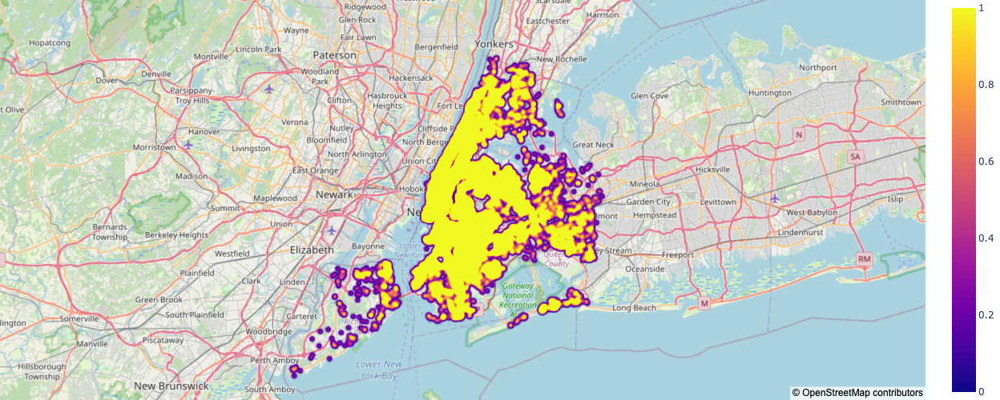

In [6]:
fig = px.density_mapbox(
    df,
    lat="latitude",
    lon="longitude",
    radius=5,
    mapbox_style="stamen-terrain",
    zoom=9,
    height=500,
)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})

fig.show()

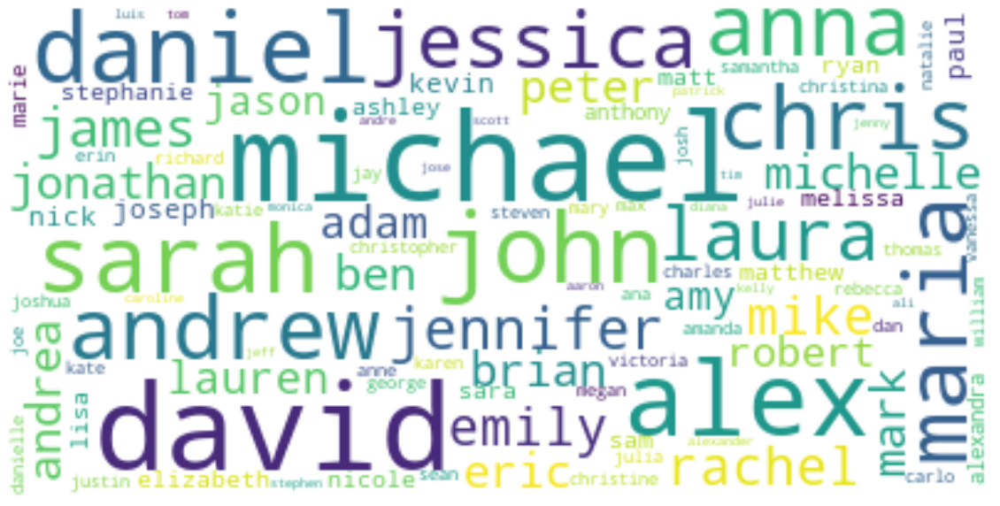

In [8]:
%matplotlib inline
wc = WordCloud(max_font_size=50, max_words=100, background_color="white")
wc.generate(
    " ".join(
        df[["host_id", "host_name_cleaned"]]
        .drop_duplicates()
        .host_name_cleaned.astype(str)
        .tolist()
    )
)

plt.figure(figsize=(20, 20))
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

# Price prediction

## Feature generation

In [9]:
numeric_col_names = [
    "minimum_nights",
    "number_of_reviews",
    "reviews_per_month",
    "calculated_host_listings_count",
    "availability_365",
]

categorical_col_names = ["neighbourhood_group", "neighbourhood", "room_type"]
geo_col_names = ["latitude", "longitude", "price", "room_type"]
text_col_names = ["name", "host_name"]

In [10]:
numeric_transformer = data_processing.get_numeric_transformer()
categoric_transformer = data_processing.get_categorical_transformer()
geo_transformer = data_processing.get_geo_transformer(radiuses=[0.1, 0.5, 2, 7, 10])
text_transformer = data_processing.get_text_transformer(
    max_features=1000, ngram_min=1, ngram_max=3
)

In [11]:
featuring_pipeline = data_processing.build_featuring_pipeline(
    numeric_transformer,
    categoric_transformer,
    geo_transformer,
    text_transformer,
    numeric_col_names,
    categorical_col_names,
    geo_col_names,
    text_col_names,
)

In [12]:
train_df, test_df = model_selection.train_test_split(
    df, train_size=0.8, random_state=random_seed
)

In [12]:
%%time
train_X = featuring_pipeline.fit_transform(train_df, train_df.price)
test_X = featuring_pipeline.transform(test_df)

# with open("model/featuring_pipeline.pkl", 'wb') as fp:
#     pickle.dump(featuring_pipeline, fp)

# with open("model/featuring_pipeline.pkl", "rb") as fp:
#     featuring_pipeline = pickle.load(fp)

[Pipeline] ..... (step 1 of 2) Processing Preprocessing, total= 7.3min
[Pipeline] . (step 2 of 2) Processing Feature selection, total= 7.3min
CPU times: user 51min 23s, sys: 15 s, total: 51min 38s
Wall time: 16min 2s


## Modeling

In [15]:
model_pipeline = modeling.build_model_pipeline()
pipe = pipeline.Pipeline(
    steps=[("Featuring", featuring_pipeline), ("Modelling", model_pipeline)]
)
pipe

Pipeline(steps=[('Featuring',
                 Pipeline(steps=[('Preprocessing',
                                  ColumnTransformer(n_jobs=-1,
                                                    transformers=[('Numeric',
                                                                   Pipeline(steps=[('functiontransformer',
                                                                                    FunctionTransformer(func=<ufunc 'log1p'>)),
                                                                                   ('simpleimputer',
                                                                                    SimpleImputer(fill_value=-1,
                                                                                                  strategy='constant'))],
                                                                            verbose=True),
                                                                   ['minimum_nights',
                                                                    'number_of_reviews',
                                                                    'reviews_per_month',
                                                                    'calculated_ho...
                                                                                    FunctionTransformer(func=<function clean_text at 0x7fb9c1bddca0>)),
                                                                                   ('tfidfvectorizer',
                                                                                    TfidfVectorizer(max_features=1000,
                                                                                                    ngram_range=(1,
                                                                                                                 3)))],
                                                                            verbose=True),
                                                                   ['host_name'])],
                                                    verbose=True)),
                                 ('Feature selection',
                                  SelectFromModel(estimator=RandomForestRegressor(n_jobs=-1)))],
                          verbose=True)),
                ('Modelling',
                 Pipeline(steps=[('Modelling',
                                  RandomForestRegressor(n_jobs=-1))]))])

## Parameters tuning

In [15]:
min_test_mae = np.inf
cv_results = []
for _ in tqdm.notebook.trange(50):
    model_params = {
        "n_estimators": int(np.random.uniform(300, 5000)),
        "max_depth": int(np.random.uniform(3, 10)),
        "random_state": random_seed,
        "min_samples_leaf": int(np.random.uniform(1, 6)),
    }
    model_pipeline = modeling.build_model_pipeline(model_params)

    model_pipeline.fit(train_X, train_df.price)

    train_preds = model_pipeline.predict(train_X)
    test_preds = model_pipeline.predict(test_X)

    train_mae = metrics.mean_absolute_error(train_df.price, train_preds)
    test_mae = metrics.mean_absolute_error(test_df.price, test_preds)
    if test_mae < min_test_mae:
        best_model_pipeline = model_pipeline
        min_test_mae = test_mae

    model_params.update({"train_mae": train_mae, "test_mae": test_mae})
    cv_results.append(model_params)

# with open("model/best_model_pipeline.pkl", "wb") as fp:
#     pickle.dump(best_model_pipeline, fp)

  0%|          | 0/50 [00:00<?, ?it/s]

In [19]:
with open("model/best_model_pipeline.pkl", "rb") as fp:
    best_model_pipeline = pickle.load(fp)

In [18]:
# eval_df = (
#     pd.DataFrame(cv_results).drop(columns=["random_state"]).sort_values("test_mae")
# )
# eval_df.to_csv("params_tuning.csv", index=False)
eval_df = pd.read_csv("params_tuning.csv")
eval_df.head()

,n_estimators,max_depth,min_samples_leaf,train_mae,test_mae
0,2776,9,5,45.306548,47.828982
1,3413,9,5,45.308387,47.832085
2,1396,8,5,46.629976,48.477375
3,1874,8,5,46.624702,48.478988
4,3114,8,4,46.732556,48.595072


## Evaluation

In [22]:
pipe = pipeline.Pipeline(
    steps=[("Featuring", featuring_pipeline), ("Modelling", best_model_pipeline)]
)

In [ ]:
%%time 
train_preds = pipe.predict(train_df)
test_preds = pipe.predict(test_df)

CPU times: user 25 s, sys: 1.09 s, total: 26.1 s
Wall time: 11min 52s


In [28]:
[x for x in input_feature_names if "median_price_" in x]

['median_price_Entire home/apt_radius_0.1',
 'median_price_Entire home/apt_radius_0.5',
 'median_price_Entire home/apt_radius_2',
 'median_price_Entire home/apt_radius_7',
 'median_price_Entire home/apt_radius_10',
 'median_price_Private room_radius_0.1',
 'median_price_Private room_radius_0.5',
 'median_price_Private room_radius_2',
 'median_price_Private room_radius_7',
 'median_price_Private room_radius_10',
 'median_price_Shared room_radius_0.1',
 'median_price_Shared room_radius_0.5',
 'median_price_Shared room_radius_2',
 'median_price_Shared room_radius_7',
 'median_price_Shared room_radius_10']

In [20]:
input_feature_names = evaluation.get_feature_names(
    pipe,
    numeric_col_names,
    categorical_col_names,
    text_col_names,
)
selected_feature_names = evaluation.get_selected_feature_names(
    pipe, input_feature_names
)

print(len(input_feature_names))
print(len(selected_feature_names))

2263
247


<Figure size 576x1440 with 0 Axes>

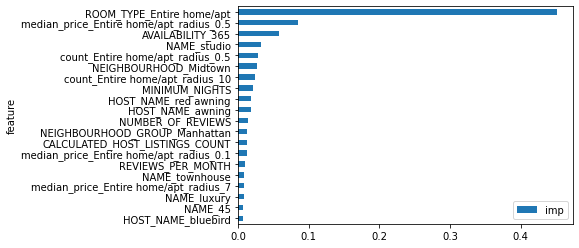

In [25]:
%matplotlib inline
evaluation.show_feature_importance(pipe, selected_feature_names, n_top=20)

Train preds distribution


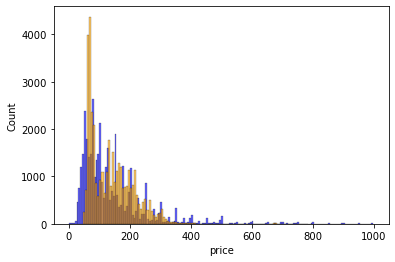

Test preds distribution


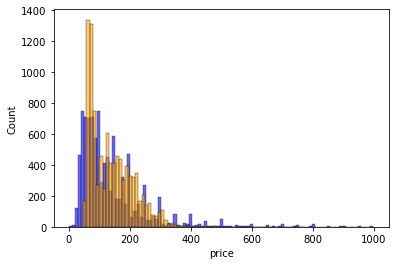

In [ ]:
base_hist_args = {"kde": False, "alpha": 0.6}
print("Train preds distribution")
sns.histplot(train_df.price, color="blue", **base_hist_args)
sns.histplot(train_preds, color="orange", **base_hist_args)
plt.show()

print("Test preds distribution")
sns.histplot(test_df.price, color="blue", **base_hist_args)
sns.histplot(test_preds, color="orange", **base_hist_args)
plt.show()

In [ ]:
mae = metrics.mean_absolute_error(test_df.price, test_preds)
mse = metrics.mean_squared_error(test_df.price, test_preds)
r2 = metrics.r2_score(test_df.price, test_preds)
print(f"mae: {mae}, mse: {mse}, r2: {r2}")

mae: 47.82898177006621, mse: 6942.42476084114, r2: 0.4630089772995547


# To do
- Classification model for highly expensive apt
- Add external data like park, river, etc locations